In [5]:
import trimesh
import numpy as np

# Load the 3D model
mesh_path = r"C:\Users\Maxim\Documents\03 University\04 Msci Project\MastersProject\person_0.obj"  # Replace with your 3D model file path
mesh = trimesh.load(mesh_path)


# Access vertex coordinates
vertices = mesh.vertices  # Nx3 array of vertex positions

# Separate x, y, and z values
x_values = vertices[:, 0]  # All x-coordinates
y_values = vertices[:, 1]  # All y-coordinates
z_values = vertices[:, 2]  # All z-coordinates

# Print results
print("X values:", x_values)
print("Y values:", y_values)
print("Z values:", z_values)

# Calculate mean values
mean_x = x_values.mean()
mean_y = y_values.mean()
mean_z = z_values.mean()

# Calculate the minimum y value
min_y = y_values.min()
max_y = y_values.max()

print(f"Mean X: {mean_x}, Mean Y: {mean_y}, Mean Z: {mean_z}")
print(f"Minimum Y: {min_y}")
print(f"Maximum Y: {max_y}")


# Centre the mesh on 0,0,0
target_coordinates = np.array([0, 0, 0])
current_centroid = mesh.centroid
translation_vector = target_coordinates - current_centroid
translation_matrix = trimesh.transformations.translation_matrix(translation_vector)
mesh.apply_transform(translation_matrix)
print("New centroid:", mesh.centroid)


# Scale the mesh 
desired_height = 1.75
current_height = mesh.bounds[1][2] - mesh.bounds[0][2]
scaling_factor = desired_height / current_height
scaling_matrix = trimesh.transformations.scale_matrix(scaling_factor, origin=mesh.centroid)
mesh.apply_transform(scaling_matrix)

# Rotate the mesh to face the xy plane
rotation_matrix1 = trimesh.transformations.rotation_matrix(
    angle=300, 
    direction=[1, 0, 0],  # Rotate around the X-axis
    point=mesh.centroid  # Rotation around the origin
)
mesh.apply_transform(rotation_matrix1)

rotation_matrix2 = trimesh.transformations.rotation_matrix(
    angle=90,  # 90 degrees
    direction=[0, 0, 1],  # Rotate around the Z-axis
    point=mesh.centroid  # Rotation around the origin
)
mesh.apply_transform(rotation_matrix2)


emitter_position = np.array([2, 0,2])  # Emitter at the origin
receiver_position = np.array([2, 0,2]) 

# Function to calculate RCS for each vertex
def calculate_vertex_rcs(mesh, emitter_position, receiver_position):
    # Initialize an array to store RCS values for each vertex
    vertex_rcs = np.zeros(len(mesh.vertices))

    # Loop through all triangles in the mesh
    for face in mesh.faces:
        # Get the vertices of the triangle
        vertices = mesh.vertices[face]

        # Calculate triangle normal
        edge1 = vertices[1] - vertices[0]
        edge2 = vertices[2] - vertices[0]
        normal = np.cross(edge1, edge2)
        normal = normal / np.linalg.norm(normal)  # Normalize the normal

        # Calculate centroid of the triangle
        centroid = np.mean(vertices, axis=0)

        # Vector from emitter to centroid
        emitter_to_centroid = centroid - emitter_position
        emitter_to_centroid = emitter_to_centroid / np.linalg.norm(emitter_to_centroid)
        centroid_to_reciver = receiver_position - centroid
        centroid_to_reciver = centroid_to_reciver / np.linalg.norm(centroid_to_reciver)
        

        # Check if the triangle faces the emitter
        if np.dot(normal, emitter_to_centroid) < 0:  # Only consider illuminated faces
            # Calculate RCS contribution for the triangle
            # Geometric optics backscatter: |n . d|^2 * Area
            # TODO I think this the problem
            projected_area = 0.5 * np.linalg.norm(np.cross(edge1, edge2))
            #projected_area = 1
            rcs_contribution = (np.dot(normal, centroid_to_reciver) ** 2) * projected_area
            # Distribute the RCS contribution equally to the triangle's vertices
            for vertex_index in face:
                vertex_rcs[vertex_index] += rcs_contribution / 3  # Equal share to each vertex

    return vertex_rcs

# Calculate RCS for each vertex
vertex_rcs = calculate_vertex_rcs(mesh, emitter_position, receiver_position)

# Print the RCS values for the first few vertices
for i, rcs in enumerate(vertex_rcs[:10]):
    print(f"Vertex {i}: RCS = {rcs:.6f} m^2")
    
    
# Map each RCS to the given vertex
print(mesh.bounds)

X values: [ 0.06441192  0.06848084  0.06915226 ... -0.03076031 -0.02867436
 -0.02637631]
Y values: [-0.7298376  -0.72844666 -0.7297477  ... -0.7581969  -0.7586867
 -0.7591519 ]
Z values: [43.118446 43.117653 43.11769  ... 43.052998 43.05422  43.055004]
Mean X: 0.0027777003614916284, Mean Y: -0.45822627932654897, Mean Z: 43.04518893097852
Minimum Y: -0.876941
Maximum Y: 0.8228848
New centroid: [ 3.07656741e-17 -6.47995564e-17 -1.94104403e-13]
Vertex 0: RCS = 0.000000 m^2
Vertex 1: RCS = 0.000000 m^2
Vertex 2: RCS = 0.000000 m^2
Vertex 3: RCS = 0.000000 m^2
Vertex 4: RCS = 0.000000 m^2
Vertex 5: RCS = 0.000000 m^2
Vertex 6: RCS = 0.000000 m^2
Vertex 7: RCS = 0.000000 m^2
Vertex 8: RCS = 0.000000 m^2
Vertex 9: RCS = 0.000000 m^2
[[-0.68071676 -0.63012449 -2.55508276]
 [ 1.06966275  0.90014137  2.16016139]]


[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


C:\Users\Maxim\anaconda3\Lib\site-packages\pyvista\core\utilities\points.py:55: UserWarning: Points is not a float type. This can cause issues when transforming or applying filters. Casting to ``np.float32``. Disable this by passing ``force_float=False``.
  warnings.warn(
C:\Users\Maxim\anaconda3\Lib\site-packages\pyvista\jupyter\notebook.py:37: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


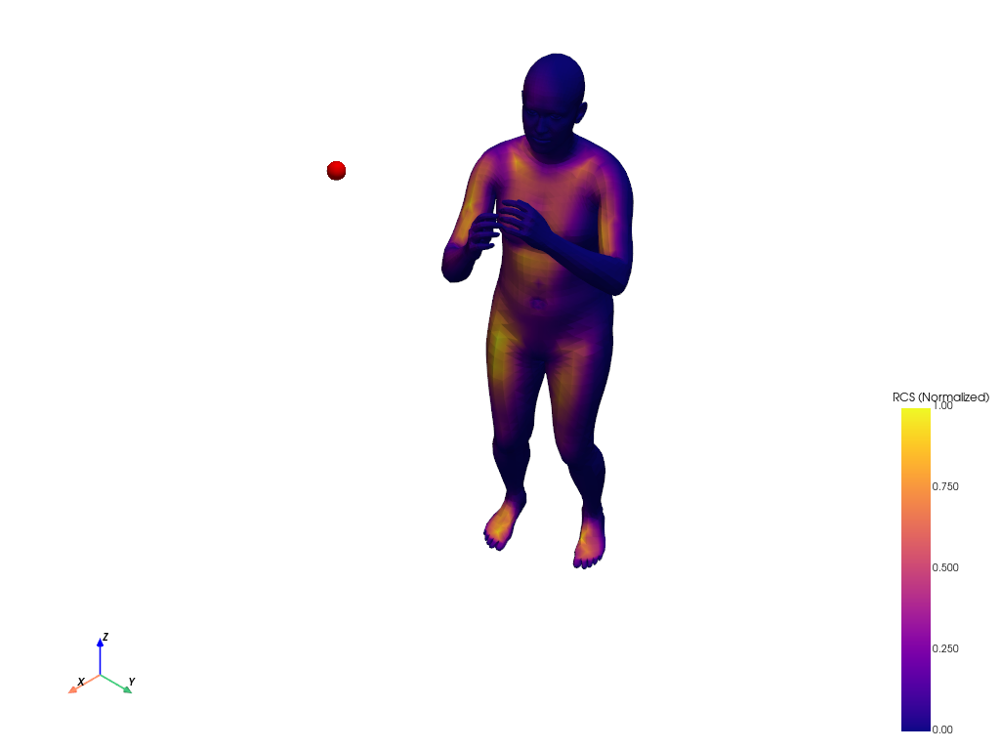

In [2]:
import pyvista as pv
import numpy as np
import trimesh
from matplotlib import cm

print(vertex_rcs[:10])
# Normalize RCS values for visualization (scale between 0 and 1)
vertex_rcs_normalized = (vertex_rcs - np.min(vertex_rcs)) / (np.max(vertex_rcs) - np.min(vertex_rcs))
print(vertex_rcs_normalized[:10])
# Assign colors to vertices based on their RCS values
cmap = cm.plasma  # Use a colormap for the heatmap (blue -> red)
colors = (cmap(vertex_rcs_normalized)[:, :3] * 255).astype(np.uint8)  # Convert to RGB (0-255)

# Convert the trimesh mesh to a PyVista PolyData mesh
faces = mesh.faces

# Convert faces into the format required by PyVista: [n_pts, v0, v1, v2] for each face
pyvista_faces = np.hstack([[3] + list(face) for face in faces]).astype(np.int32)

# Create the PyVista PolyData object
mesh_pv = pv.PolyData(mesh.vertices, pyvista_faces)

# Add the normalized RCS values as scalars to the PyVista mesh
mesh_pv["RCS"] = vertex_rcs_normalized  # Add scalar values for colormap mapping

# Define the emitter and receiver positions
emitter_position = np.array([2, 0, 2]) 
receiver_position = np.array([2, 0, 2]) 

# Create a PyVista plotter
plotter = pv.Plotter()

# Add the mesh to the plotter with the RCS scalar field
plotter.add_mesh(
    mesh_pv, scalars="RCS", cmap="plasma", scalar_bar_args={
        "title": "RCS (Normalized)",
        "n_labels": 5,
        "vertical": True,
        "title_font_size": 12,
        "label_font_size": 10,
    }
)

# Add the emitter point to the plotter
plotter.add_points(
    emitter_position.reshape(1, -1),  # Ensure it's a 2D array with shape (1, 3)
    color="yellow",  # Color of the emitter point
    point_size=20,   # Size of the emitter point
    render_points_as_spheres=True  # Make the point look like a sphere
)

# Add the receiver point to the plotter
plotter.add_points(
    receiver_position.reshape(1, -1),  # Ensure it's a 2D array with shape (1, 3)
    color="red",  # Color of the receiver point
    point_size=20,   # Size of the receiver point
    render_points_as_spheres=True  # Make the point look like a sphere
)

# Add axes to the visualization
plotter.show_axes()

# Display the mesh
plotter.show()


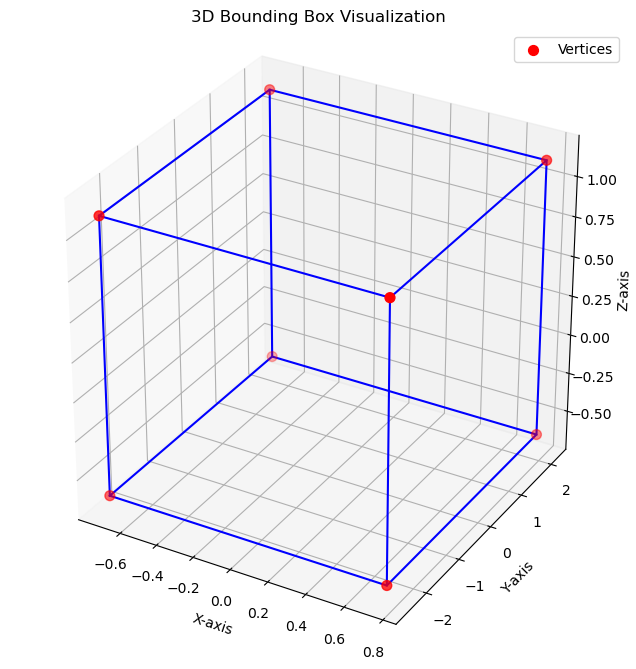

In [3]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

def plot_bounding_box_3d(bounds):
    """
    Plots a 3D bounding box in space with labeled axes.

    Parameters:
    - bounds: A 2x3 array where:
      bounds[0] represents the min values [min_x, min_y, min_z]
      bounds[1] represents the max values [max_x, max_y, max_z]
    """
    # Extract min and max bounds
    min_vals, max_vals = bounds

    # Define the 8 corners of the bounding box
    corners = np.array([
        [min_vals[0], min_vals[1], min_vals[2]],  # Bottom-back-left
        [max_vals[0], min_vals[1], min_vals[2]],  # Bottom-back-right
        [max_vals[0], max_vals[1], min_vals[2]],  # Bottom-front-right
        [min_vals[0], max_vals[1], min_vals[2]],  # Bottom-front-left
        [min_vals[0], min_vals[1], max_vals[2]],  # Top-back-left
        [max_vals[0], min_vals[1], max_vals[2]],  # Top-back-right
        [max_vals[0], max_vals[1], max_vals[2]],  # Top-front-right
        [min_vals[0], max_vals[1], max_vals[2]],  # Top-front-left
    ])

    # Define the edges of the bounding box
    edges = [
        [corners[0], corners[1], corners[2], corners[3], corners[0]],  # Bottom face
        [corners[4], corners[5], corners[6], corners[7], corners[4]],  # Top face
        [corners[0], corners[4]],  # Vertical edges
        [corners[1], corners[5]],
        [corners[2], corners[6]],
        [corners[3], corners[7]],
    ]

    # Plot the bounding box
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111, projection='3d')
    
    # Draw edges
    for edge in edges:
        edge = np.array(edge)
        ax.plot(edge[:, 0], edge[:, 1], edge[:, 2], color="blue")

    # Draw vertices
    ax.scatter(corners[:, 0], corners[:, 1], corners[:, 2], color="red", s=50, label="Vertices")

    # Set labels and limits
    ax.set_xlabel("X-axis")
    ax.set_ylabel("Y-axis")
    ax.set_zlabel("Z-axis")
    ax.set_title("3D Bounding Box Visualization")

    # Set equal aspect ratio
    ax.set_box_aspect([1, 1, 1])  # Equal aspect ratio for all axes
    plt.legend()
    plt.show()

# Example bounds
bounds = np.array([[-0.72358905, -2.55683664, -0.6265688],
                   [ 0.75889056,  2.16129195,  1.1234312 ]])

plot_bounding_box_3d(bounds)


In [4]:
# Color vertices based on RCS values (normalized for visualization)
vertex_colors = (vertex_rcs - np.min(vertex_rcs)) / (np.max(vertex_rcs) - np.min(vertex_rcs))
vertex_colors = np.clip(vertex_colors, 0, 1) * 255  # Scale to 0-255
vertex_colors = np.array([vertex_colors, vertex_colors, vertex_colors, np.full_like(vertex_colors, 255)]).T

# Set the vertex colors
mesh.visual.vertex_colors = vertex_colors

# Show the mesh
mesh.show()
# vertices = mesh.vertices  # Nx3 array of vertex positions

# # Separate x, y, and z values
# x_values = vertices[:, 0]  # All x-coordinates
# y_values = vertices[:, 1]  # All y-coordinates
# z_values = vertices[:, 2]  # All z-coordinates

# # Print results
# print("X values:", x_values)
# print("Y values:", y_values)
# print("Z values:", z_values)

# # Calculate mean values
# mean_x = x_values.mean()
# mean_y = y_values.mean()
# mean_z = z_values.mean()

# # Calculate the minimum y value
# min_y = y_values.min()
# max_y = y_values.max()

# print(f"Mean X: {mean_x}, Mean Y: {mean_y}, Mean Z: {mean_z}")
# print(f"Minimum Y: {min_y}")
# print(f"Maximum Y: {max_y}")


In [10]:
from matplotlib import cm
import matplotlib.pyplot as plt
import trimesh
import numpy as np

# Example mesh and vertex_rcs (replace with actual values)
# mesh = trimesh.load('path_to_your_mesh.obj')  # Uncomment and load your mesh
# vertex_rcs = np.random.random(len(mesh.vertices))  # Replace with your calculated RCS values

# Normalize RCS values for visualization (scale between 0 and 1)
vertex_rcs_normalized = (vertex_rcs - np.min(vertex_rcs)) / (np.max(vertex_rcs) - np.min(vertex_rcs))
print(vertex_rcs_normalized)
#gamma = 0.5  # < 1 to brighten, > 1 to darken
#vertex_rcs_normalized = np.power(vertex_rcs_normalized, gamma)

# Assign colors to vertices based on their RCS values
cmap = cm.plasma  # Use a colormap for the heatmap
colors = cmap(vertex_rcs_normalized)  # RGBA colors

# Set vertex colors in the mesh
mesh.visual.vertex_colors = (colors[:, :3] * 255).astype(np.uint8)  # Convert RGBA to RGB

# Display the mesh with heatmap
mesh.show()  # Displays the mesh with RCS as a heatmap



[0. 0. 0. ... 0. 0. 0.]


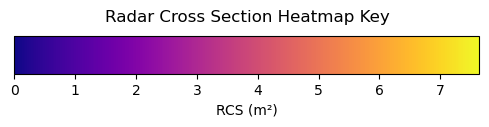

In [6]:

# Create a heatmap key
fig, ax = plt.subplots(figsize=(6, 1))  # Create a figure and axis for the colorbar
fig.subplots_adjust(bottom=0.5)  # Adjust layout to fit the colorbar

# Normalization for color key
norm = plt.Normalize(vmin=np.min(vertex_rcs), vmax=np.max(vertex_rcs))
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)

# Add color bar explicitly to the axis
cbar = fig.colorbar(sm, cax=ax, orientation="horizontal")
cbar.set_label("RCS (m²)")  # Add label to the color bar
ax.set_title("Radar Cross Section Heatmap Key", pad=10)  # Optional title for the heatmap key

# Show the heatmap key
plt.show()

In [7]:
import trimesh
import numpy as np

# Load in the meshes
mesh1_path = r"C:\Users\Maxim\Documents\03 University\04 Msci Project\MastersProject\person_0.obj"  # Replace with your 3D model file path
mesh1 = trimesh.load(mesh1_path)

mesh2_path = r"C:\Users\Maxim\Documents\03 University\04 Msci Project\MastersProject\person_0.obj"  # Replace with your 3D model file path
mesh2 = trimesh.load(mesh2_path)

# For each vertex compare their positions and calculate positional difference

# Calculate the velocity of each point
# Assumed FPS of 30

# visualise this on the mesh in a similar manner as midas with red being positive velocity and blue negative velocity

In [17]:
import trimesh
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
import matplotlib.cm as cm

# Load in the meshes
mesh1_path = r"C:\Users\Maxim\Documents\03 University\04 Msci Project\MastersProject\person_0.obj"  # Frame 1
mesh2_path = r"C:\Users\Maxim\Documents\03 University\04 Msci Project\MastersProject\person_1.obj"  # Frame 2
mesh1 = trimesh.load(mesh1_path)
mesh2 = trimesh.load(mesh2_path)

# Ensure both meshes have the same number of vertices
assert len(mesh1.vertices) == len(mesh2.vertices), "Meshes must have the same number of vertices!"


# Specify the target coordinates (x, y, z)
target_coordinates = np.array([0, 0, 0])

# Compute the current centroid of the mesh
current_centroid = mesh1.centroid

# Compute the translation vector needed to move the centroid to the target position
translation_vector1 = target_coordinates - mesh1.centroid
translation_vector2 = target_coordinates - mesh2.centroid


# Create a translation transformation matrix
translation_matrix1 = trimesh.transformations.translation_matrix(translation_vector1)
translation_matrix2 = trimesh.transformations.translation_matrix(translation_vector2)

# Apply the translation to the mesh
mesh1.apply_transform(translation_matrix1)
mesh2.apply_transform(translation_matrix2)

# Verify the new position
print("New centroid:", mesh1.centroid)


# Desired height
desired_height = 1.75

# Get the current height of the model
# The height is the difference between the max and min values along the Z-axis
current_height = mesh1.bounds[1][2] - mesh1.bounds[0][2]

# Calculate the scaling factor
scaling_factor = desired_height / current_height

# Create a scaling transformation matrix
scaling_matrix = trimesh.transformations.scale_matrix(scaling_factor, origin=mesh.centroid)

# Apply the scaling transformation
mesh1.apply_transform(scaling_matrix)
mesh2.apply_transform(scaling_matrix)


rotation_matrix = trimesh.transformations.rotation_matrix(
    angle=np.pi,  # 180 degrees
    direction=[1, 0, 0],  # Rotate around the X-axis
    point=[0, 0, 0]  # Rotation around the origin
)


mesh1.apply_transform(rotation_matrix)
mesh2.apply_transform(rotation_matrix)

# Calculate the positional differences between corresponding vertices
positional_differences = mesh2.vertices - mesh1.vertices

# Assume FPS of 30, so time between frames is 1/30 seconds
fps = 30
delta_t = 1 / fps

# Calculate velocity (magnitude of displacement divided by delta_t)
velocities = np.linalg.norm(positional_differences, axis=1) / delta_t

# Determine direction: Positive or Negative based on displacement along a specific axis (e.g., Z-axis)
directions = np.sign(positional_differences[:, 0])  # Assuming Z-axis as vertical

# Color velocities: Red for positive, blue for negative
norm = Normalize(vmin=-np.max(velocities), vmax=np.max(velocities))  # Normalize velocity values for coloring
cmap = cm.get_cmap("coolwarm")  # Red (positive) to Blue (negative)
vertex_colors = cmap(norm(directions * velocities))

# Apply colors to the mesh
colored_mesh = mesh2.copy()  # Use mesh2 as base


colored_mesh.visual.vertex_colors = (vertex_colors[:, :3] * 255).astype(np.uint8)  # RGB values scaled to 0-255

# Visualize the mesh
colored_mesh.show()

# Save the colored mesh for external viewing (optional)
#colored_mesh.export(r"C:\Users\Maxim\Documents\03 University\04 Msci Project\MastersProject\colored_velocity_mesh.obj")



New centroid: [ 3.07656741e-17 -6.47995564e-17 -1.94104403e-13]


C:\Users\Maxim\AppData\Local\Temp\ipykernel_41476\713579105.py:83: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap("coolwarm")  # Red (positive) to Blue (negative)


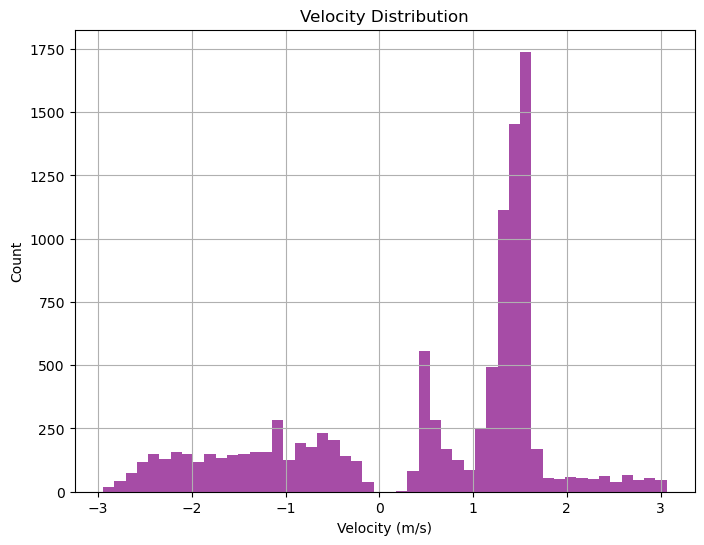

In [18]:

# Optional: Visualize velocity distribution using a histogram
plt.figure(figsize=(8, 6))
plt.hist(velocities * directions, bins=50, color='purple', alpha=0.7)
plt.title("Velocity Distribution")
plt.xlabel("Velocity (m/s)")
plt.ylabel("Count")
plt.grid(True)
plt.show()

C:\Users\Maxim\anaconda3\Lib\site-packages\pyvista\jupyter\notebook.py:37: UserWarning: Failed to use notebook backend: 

No module named 'trame'

Falling back to a static output.
  warnings.warn(


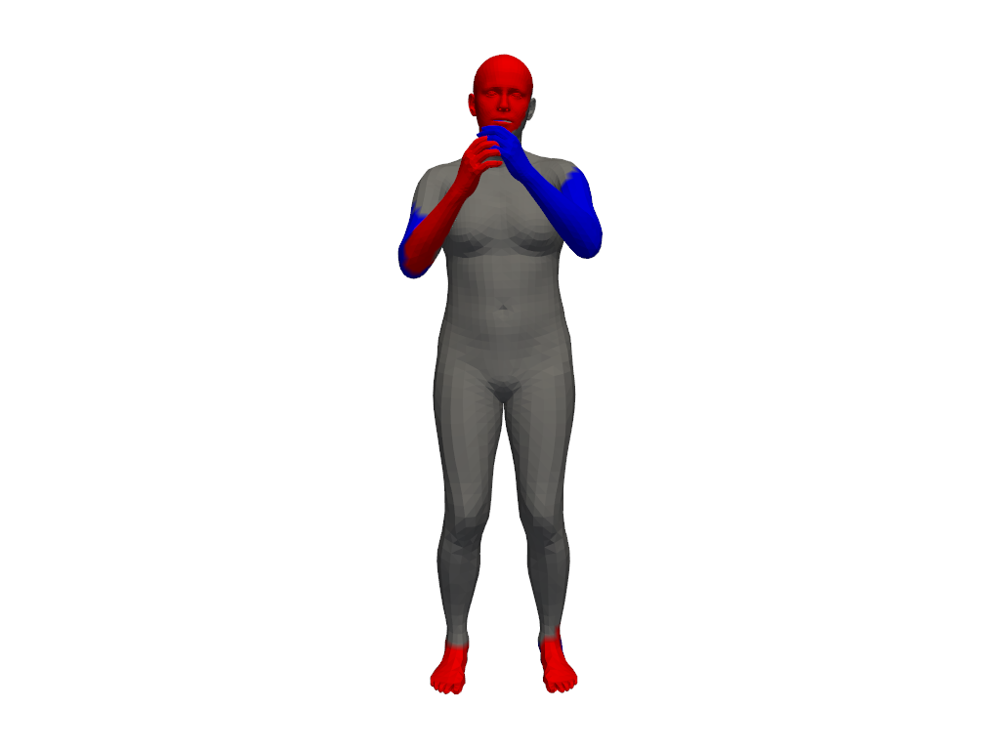

In [10]:
import trimesh
import numpy as np
import pyvista as pv

# Load in the meshes
mesh1_path = r"C:\Users\Maxim\Documents\03 University\04 Msci Project\MastersProject\person_0.obj"  # Frame 1
mesh2_path = r"C:\Users\Maxim\Documents\03 University\04 Msci Project\MastersProject\person_1.obj"  # Frame 2
mesh1 = trimesh.load(mesh1_path)
mesh2 = trimesh.load(mesh2_path)

# Specify the target coordinates (x, y, z)
target_coordinates = np.array([0, 0, 0])

# Compute the current centroid of the mesh
current_centroid = mesh1.centroid

# Compute the translation vector needed to move the centroid to the target position
translation_vector1 = target_coordinates - mesh1.centroid
translation_vector2 = target_coordinates - mesh2.centroid


# Create a translation transformation matrix
translation_matrix1 = trimesh.transformations.translation_matrix(translation_vector1)
translation_matrix2 = trimesh.transformations.translation_matrix(translation_vector2)

# Apply the translation to the mesh
mesh1.apply_transform(translation_matrix1)
mesh2.apply_transform(translation_matrix2)

# Ensure both meshes have the same number of vertices
assert len(mesh1.vertices) == len(mesh2.vertices), "Meshes must have the same number of vertices!"

# Fix normals (optional, for consistent rendering)
mesh1.fix_normals()
mesh2.fix_normals()

# Rotate the mesh to align it
# Example: Rotate around X-axis by 90 degrees to make the body face the camera
rotation_matrix = trimesh.transformations.rotation_matrix(
    angle=np.radians(180),  # Rotate 90 degrees
    direction=[1, 0, 0],  # Rotate around the X-axis
    point=[0, 0, 0]  # Center of rotation
)
# Apply rotation to the mesh
mesh1.apply_transform(rotation_matrix)
mesh2.apply_transform(rotation_matrix)


# Calculate the positional differences between corresponding vertices
positional_differences = mesh2.vertices - mesh1.vertices

# Assume FPS of 30, so time between frames is 1/30 seconds
fps = 30
delta_t = 1 / fps

# Calculate velocity (magnitude of displacement divided by delta_t)
velocities = np.linalg.norm(positional_differences, axis=1) / delta_t

# Determine direction: Positive or Negative based on displacement along a specific axis (e.g., Z-axis)
directions = np.sign(positional_differences[:, 0])  # Assuming Z-axis as vertical

# Combine direction and velocity
signed_velocities = directions * velocities

# Define buffer zone: ±10% of the maximum velocity
buffer_zone = 0.4 * np.max(np.abs(signed_velocities))

# Assign colors: Grey for velocities in the buffer, Red for positive, Blue for negative
colors = np.zeros((len(signed_velocities), 3))  # Initialize RGB colors
for i, vel in enumerate(signed_velocities):
    if -buffer_zone <= vel <= buffer_zone:  # Buffer zone
        colors[i] = [0.5, 0.5, 0.5]  # Grey
    elif vel > buffer_zone:  # Positive velocity
        colors[i] = [1, 0, 0]  # Red
    elif vel < -buffer_zone:  # Negative velocity
        colors[i] = [0, 0, 1]  # Blue

        
# Convert Trimesh to PyVista mesh
pyvista_mesh = pv.PolyData(mesh2.vertices, np.hstack((np.full((mesh2.faces.shape[0], 1), 3), mesh2.faces)).astype(np.int32))

pyvista_mesh2 = pv.PolyData(mesh1.vertices, np.hstack((np.full((mesh1.faces.shape[0], 1), 3), mesh1.faces)).astype(np.int32))

# Add colors to the mesh
pyvista_mesh["Velocity Color"] = colors

# Visualize in PyVista
plotter = pv.Plotter()
plotter.add_mesh(pyvista_mesh, scalars="Velocity Color", rgb=True, show_edges=False)
#plotter.add_mesh(pyvista_mesh2, rgb=False, show_edges=False)
plotter.background_color = "white"  # Optional: Set background color to white
plotter.camera_position = 'xy'  # Align the camera to the XY plane
plotter.show()


In [9]:
print(positional_differences[4])

[ 1.50233633e-05 -5.53838845e-03  1.23880686e-02]


## Calculate Intensity mapping

In [8]:
import trimesh
import numpy as np
import pyvista as pv
import time




# Load in the meshes
mesh1_path = r"C:\Users\Maxim\Documents\03 University\04 Msci Project\MastersProject\person_0.obj"  # Frame 1
mesh2_path = r"C:\Users\Maxim\Documents\03 University\04 Msci Project\MastersProject\person_1.obj"  # Frame 2
mesh1 = trimesh.load(mesh1_path)
mesh2 = trimesh.load(mesh2_path)

# Specify the target coordinates (x, y, z)
target_coordinates = np.array([0, 0, 0])

# Compute the current centroid of the mesh
current_centroid = mesh1.centroid

# Compute the translation vector needed to move the centroid to the target position
translation_vector1 = target_coordinates - mesh1.centroid
translation_vector2 = target_coordinates - mesh2.centroid


# Create a translation transformation matrix
translation_matrix1 = trimesh.transformations.translation_matrix(translation_vector1)
translation_matrix2 = trimesh.transformations.translation_matrix(translation_vector2)

# Apply the translation to the mesh
mesh1.apply_transform(translation_matrix1)
mesh2.apply_transform(translation_matrix2)

# Ensure both meshes have the same number of vertices
assert len(mesh1.vertices) == len(mesh2.vertices), "Meshes must have the same number of vertices!"

# Fix normals (optional, for consistent rendering)
mesh1.fix_normals()
mesh2.fix_normals()

# Rotate the mesh to align it
# Example: Rotate around X-axis by 90 degrees to make the body face the camera
rotation_matrix = trimesh.transformations.rotation_matrix(
    angle=np.radians(180),  # Rotate 90 degrees
    direction=[1, 0, 0],  # Rotate around the X-axis
    point=[0, 0, 0]  # Center of rotation
)
# Apply rotation to the mesh
mesh1.apply_transform(rotation_matrix)
mesh2.apply_transform(rotation_matrix)


# Calculate the positional differences between corresponding vertices
positional_differences = mesh2.vertices - mesh1.vertices

# Assume FPS of 30, so time between frames is 1/30 seconds
fps = 30
delta_t = 1 / fps

# Calculate velocity (magnitude of displacement divided by delta_t)
velocities = np.linalg.norm(positional_differences, axis=1) / delta_t

# Filter these to only be the visible points from the camera

# multiply each velocity by sin(angle to camera of triangle) to get the intensity
print(velocities.mean)

# Determine direction: Positive or Negative based on displacement along a specific axis (e.g., Z-axis)
directions = np.sign(positional_differences[:, 2])  # Assuming Z-axis as vertical

# Combine direction and velocity
signed_velocities = directions * velocities

sensor_position = np.array([0, 1, 3])


start_time = time.time()
# Perform raycasting for visibility
visible_indices = []
for i, vertex in enumerate(mesh2.vertices):
    
    ray_direction = sensor_position - vertex
    ray_origin = vertex + 1e-4 * ray_direction
    is_visible = not mesh2.ray.intersects_any([ray_origin], [ray_direction])
    if is_visible:
        visible_indices.append(i)
        
end_time = time.time() 

print(len(mesh2.vertices))
print(len(visible_indices))
# Calculate velocity relative to the sensor
relative_velocities = []
for i in visible_indices:
    vertex = mesh2.vertices[i]
    velocity = signed_velocities[i]
    line_of_sight = (vertex - sensor_position) / np.linalg.norm(vertex - sensor_position)
    relative_velocity = np.dot(velocity, line_of_sight)
    relative_velocities.append((i, relative_velocity))

# Output results
#print(f"Relative velocities for visible vertices: {relative_velocities}")


elapsed_time = end_time - start_time
print(f"Execution time: {elapsed_time:.6f} seconds")


<built-in method mean of numpy.ndarray object at 0x00000158D27E5650>
10475
4797
Execution time: 4.324530 seconds


In [10]:
import trimesh
import numpy as np
import pyvista as pv
import time




# Load in the meshes
mesh1_path = r"C:\Users\Maxim\Documents\03 University\04 Msci Project\MastersProject\person_0.obj"  # Frame 1
mesh2_path = r"C:\Users\Maxim\Documents\03 University\04 Msci Project\MastersProject\person_1.obj"  # Frame 2
mesh1 = trimesh.load(mesh1_path)
mesh2 = trimesh.load(mesh2_path)

# Specify the target coordinates (x, y, z)
target_coordinates = np.array([0, 0, 0])

# Compute the current centroid of the mesh
current_centroid = mesh1.centroid

# Compute the translation vector needed to move the centroid to the target position
translation_vector1 = target_coordinates - mesh1.centroid
translation_vector2 = target_coordinates - mesh2.centroid


# Create a translation transformation matrix
translation_matrix1 = trimesh.transformations.translation_matrix(translation_vector1)
translation_matrix2 = trimesh.transformations.translation_matrix(translation_vector2)

# Apply the translation to the mesh
mesh1.apply_transform(translation_matrix1)
mesh2.apply_transform(translation_matrix2)

# Ensure both meshes have the same number of vertices
assert len(mesh1.vertices) == len(mesh2.vertices), "Meshes must have the same number of vertices!"

# Fix normals (optional, for consistent rendering)
mesh1.fix_normals()
mesh2.fix_normals()

# Rotate the mesh to align it
# Example: Rotate around X-axis by 90 degrees to make the body face the camera
rotation_matrix = trimesh.transformations.rotation_matrix(
    angle=np.radians(180),  # Rotate 90 degrees
    direction=[1, 0, 0],  # Rotate around the X-axis
    point=[0, 0, 0]  # Center of rotation
)
# Apply rotation to the mesh
mesh1.apply_transform(rotation_matrix)
mesh2.apply_transform(rotation_matrix)


# Calculate the positional differences between corresponding vertices
positional_differences = mesh2.vertices - mesh1.vertices

# Assume FPS of 30, so time between frames is 1/30 seconds
fps = 30
delta_t = 1 / fps

# Calculate velocity (magnitude of displacement divided by delta_t)
velocities = np.linalg.norm(positional_differences, axis=1) / delta_t

# Filter these to only be the visible points from the camera

# multiply each velocity by sin(angle to camera of triangle) to get the intensity
print(velocities.mean)

# Determine direction: Positive or Negative based on displacement along a specific axis (e.g., Z-axis)
directions = np.sign(positional_differences[:, 2])  # Assuming Z-axis as vertical

# Combine direction and velocity
signed_velocities = directions * velocities

sensor_position = np.array([0, 1, 3])


start_time = time.time()
# Perform raycasting for visibility
visible_indices = []
for face in mesh2.faces:
        # Get the vertices of the triangle
        vertices = mesh.vertices[face]

        # Calculate triangle normal
        edge1 = vertices[1] - vertices[0]
        edge2 = vertices[2] - vertices[0]
        normal = np.cross(edge1, edge2)
        normal = normal / np.linalg.norm(normal)  # Normalize the normal

        # Calculate centroid of the triangle
        centroid = np.mean(vertices, axis=0)

        # Vector from emitter to centroid
        emitter_to_centroid = centroid - emitter_position
        emitter_to_centroid = emitter_to_centroid / np.linalg.norm(emitter_to_centroid)
        centroid_to_reciver = receiver_position - centroid
        centroid_to_reciver = centroid_to_reciver / np.linalg.norm(centroid_to_reciver)
        

        # Check if the triangle faces the emitter
        if np.dot(normal, emitter_to_centroid) < 0:  # Only consider illuminated faces
            pass
            
end_time = time.time() 
elapsed_time = end_time - start_time
print(f"Execution time: {elapsed_time:.6f} seconds")
for i, vertex in enumerate(mesh2.vertices):
    
    ray_direction = sensor_position - vertex
    ray_origin = vertex + 1e-4 * ray_direction
    is_visible = not mesh2.ray.intersects_any([ray_origin], [ray_direction])
    if is_visible:
        visible_indices.append(i)
        

print(len(mesh2.vertices))
print(len(visible_indices))
# Calculate velocity relative to the sensor
relative_velocities = []
for i in visible_indices:
    vertex = mesh2.vertices[i]
    velocity = signed_velocities[i]
    line_of_sight = (vertex - sensor_position) / np.linalg.norm(vertex - sensor_position)
    relative_velocity = np.dot(velocity, line_of_sight)
    relative_velocities.append((i, relative_velocity))

# Output results
#print(f"Relative velocities for visible vertices: {relative_velocities}")





<built-in method mean of numpy.ndarray object at 0x00000158C058A670>
Execution time: 2.132820 seconds
10475
4797


In [7]:
import trimesh
import numpy as np
print(mesh2.faces.shape) 
# Create a scene for visualization
scene = trimesh.Scene()

# Add mesh2 to the scene
mesh2_trimesh = trimesh.Trimesh(vertices=mesh2.vertices, faces=mesh2.faces)
scene.add_geometry(mesh2_trimesh)

# Define the sensor as a small sphere
sensor_position = np.array([0, 0.75, 3])  # Sensor position
sensor_sphere = trimesh.creation.icosphere(radius=0.02, subdivisions=2)  # Small sphere to represent sensor
sensor_sphere.apply_translation(sensor_position)
scene.add_geometry(sensor_sphere)

# Highlight visible vertices
for index in visible_indices:
    vertex_position = mesh2.vertices[index]
    vertex_sphere = trimesh.creation.icosphere(radius=0.01, subdivisions=2)  # Smaller spheres for visible vertices
    vertex_sphere.apply_translation(vertex_position)
    # Assign a distinct color (e.g., red) to the spheres
    vertex_sphere.visual.face_colors = [255, 0, 0, 255]  # RGBA for red
    scene.add_geometry(vertex_sphere)

    
# Add axis to the scene
axis = trimesh.creation.axis(origin_size=0.05)  # Creates an XYZ axis indicator
scene.add_geometry(axis)

# Visualize the scene
scene.show()


(20908, 3)


In [13]:
# Calculate magnitude of each vertex velocity relative to sensor location
sensor_position = np.array([0, 1, 3])
print(relative_velocities[0])

magnitude_relative_velocities = []
for index, velocity in relative_velocities:
    # Normalize the direction vector from the sensor to the vertex
    vertex_position = np.array([0, 0, 0])  # Replace this with actual vertex position if available
    direction_to_sensor = vertex_position - sensor_position
    direction_to_sensor = direction_to_sensor / np.linalg.norm(direction_to_sensor)

    # Project the velocity onto the direction_to_sensor vector
    magnitude = np.dot(velocity, direction_to_sensor)
    magnitude_relative_velocities.append((index, magnitude))

# Print results
for index, magnitude in magnitude_relative_velocities:
    print(f"Vertex Index: {index}, Relative Velocity Magnitude: {magnitude}")

(16, TrackedArray([ 0.00795876, -0.05835602, -0.51010582]))
Vertex Index: 16, Relative Velocity Magnitude: 0.5023826668022778
Vertex Index: 17, Relative Velocity Magnitude: 0.4928541152443731
Vertex Index: 18, Relative Velocity Magnitude: 0.48863100568164924
Vertex Index: 27, Relative Velocity Magnitude: 0.498425247692679
Vertex Index: 28, Relative Velocity Magnitude: 0.3931406528693038
Vertex Index: 30, Relative Velocity Magnitude: 0.39095702193429427
Vertex Index: 31, Relative Velocity Magnitude: 0.3924452629001735
Vertex Index: 32, Relative Velocity Magnitude: 0.3854878936054125
Vertex Index: 33, Relative Velocity Magnitude: 0.3897422553522456
Vertex Index: 34, Relative Velocity Magnitude: 0.39011268579429176
Vertex Index: 35, Relative Velocity Magnitude: 0.3886651566244484
Vertex Index: 36, Relative Velocity Magnitude: 0.3794392271403426
Vertex Index: 37, Relative Velocity Magnitude: 0.3804585799691018
Vertex Index: 38, Relative Velocity Magnitude: 0.381816611840767
Vertex Index: 3

In [5]:
import numpy as np

# Get the coordinates of the visible vertices
visible_vertices = mesh2.vertices[visible_indices]

# Compute the bounding box of the visible vertices
min_bounds = np.min(visible_vertices, axis=0)
max_bounds = np.max(visible_vertices, axis=0)

# Divide the bounding box into 32 bins along a specific axis (e.g., Z-axis for height)
num_bins = 32
z_bins = np.linspace(min_bounds[2], max_bounds[2], num_bins + 1)

# Assign each vertex to a bin based on its Z-coordinate
bin_indices = np.digitize(visible_vertices[:, 2], z_bins) - 1  # Bin indices start from 0

# Group vertices into bins
binned_vertices = {i: [] for i in range(num_bins)}
for idx, bin_idx in enumerate(bin_indices):
    binned_vertices[bin_idx].append(visible_indices[idx])

# Print the binned vertices (each key corresponds to a bin)
for bin_idx, vertices in binned_vertices.items():
    print(f"Bin {bin_idx}: {vertices}")


KeyError: 32

In [28]:
import numpy as np

def bin_relative_velocities(magnitude_relative_velocities, vertex_positions, num_bins=32):
    """
    Bins the magnitudes of relative velocities into spatial bins based on vertex positions.

    Parameters:
        magnitude_relative_velocities (list of tuples): A list of tuples, where each tuple contains the vertex index 
                                                        and its velocity magnitude relative to the sensor.
        vertex_positions (np.ndarray): An array of shape (N, 3) containing the 3D positions of vertices.
        num_bins (int): The number of spatial bins.

    Returns:
        bins (list): A list of bins, where each bin contains the indices and magnitudes of vertices in that bin.
    """
    # Extract the vertex indices and magnitudes
    indices, magnitudes = zip(*magnitude_relative_velocities)

    # Get the positions of the corresponding vertices
    positions = vertex_positions[list(indices)]

    # Define the spatial bins
    min_coords = positions.min(axis=0)  # Minimum x, y, z coordinates
    max_coords = positions.max(axis=0)  # Maximum x, y, z coordinates

    # Split space into `num_bins` bins along each axis
    bin_edges = [
        np.linspace(min_coords[i], max_coords[i], int(np.cbrt(num_bins)) + 1)
        for i in range(3)
    ]

    # Initialize the bins
    bins = [[] for _ in range(num_bins)]

    # Assign each vertex to a spatial bin
    for idx, pos, mag in zip(indices, positions, magnitudes):
        # Determine the bin index for each axis
        bin_x = np.digitize(pos[0], bin_edges[0]) - 1
        bin_y = np.digitize(pos[1], bin_edges[1]) - 1
        bin_z = np.digitize(pos[2], bin_edges[2]) - 1

        # Calculate the overall bin index (flattening 3D bins into 1D)
        bin_index = (
            bin_x * len(bin_edges[1]) * len(bin_edges[2])
            + bin_y * len(bin_edges[2])
            + bin_z
        )

        # Add the vertex index and its magnitude to the corresponding bin
        if 0 <= bin_index < num_bins:
            bins[bin_index].append((idx, mag))

    return bins

binned_velocities = bin_relative_velocities(magnitude_relative_velocities, mesh2.vertices, num_bins=32)



In [29]:
def compute_mean_normalized_magnitudes(binned_velocities):
    num_bins = len(binned_velocities)
    mean_normalized_magnitudes = np.zeros(num_bins)

    # Flatten the list of all magnitudes to normalize
    all_magnitudes = [magnitude for bin_data in binned_velocities for _, magnitude in bin_data]

    # If no magnitudes are present, return zeros
    if len(all_magnitudes) == 0:
        return mean_normalized_magnitudes

    # Normalize magnitudes between 0 and 1
    min_magnitude = min(all_magnitudes)
    max_magnitude = max(all_magnitudes)
    range_magnitude = max_magnitude - min_magnitude
    
    normalize = lambda x: (x - min_magnitude) / range_magnitude
    
    # Compute the mean normalized magnitude for each bin
    for i, bin_data in enumerate(binned_velocities):
        if bin_data:  # If the bin is not empty
            normalized_magnitudes = [normalize(magnitude) for _, magnitude in bin_data]
            mean_normalized_magnitudes[i] = np.mean(normalized_magnitudes)
        else:
            mean_normalized_magnitudes[i] = 0

    return mean_normalized_magnitudes

In [30]:
compute_mean_normalized_magnitudes(binned_velocities)

array([0.30606883, 0.43501979, 0.        , 0.        , 0.4358874 ,
       0.47726444, 0.76396009, 0.        , 0.64016103, 0.6791589 ,
       0.75540494, 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.39118821, 0.41786697, 0.        , 0.        ,
       0.41895656, 0.41946589, 0.        , 0.        , 0.7183164 ,
       0.74156881, 0.57452196, 0.01177386, 0.77036275, 0.        ,
       0.        , 0.        ])

In [ ]:
# Now need to do this over all 250 frames.
# Then reshape array into 32,250 instead of 250,32, should be easy